# DSCI 100-004: Group 19 Proposal

## Preliminary Exploratory Data Analysis

### Reading the Aiplane Dataset

In [59]:
library(tidyverse)
library(janitor)
library(tidymodels)
install.packages("gridExtra")
library(gridExtra)

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done


Attaching package: ‘gridExtra’


The following object is masked from ‘package:dplyr’:

    combine




In [2]:
# Reading downloaded training and test datasets from Kaggle

test_set <- read_csv("test.csv") 
train_set <- read_csv("train.csv")

New names:
• `` -> `...1`
Rows: 25976 Columns: 25
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (5): Gender, Customer Type, Type of Travel, Class, satisfaction
dbl (20): ...1, id, Age, Flight Distance, Inflight wifi service, Departure/A...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
New names:
• `` -> `...1`
Rows: 103904 Columns: 25
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (5): Gender, Customer Type, Type of Travel, Class, satisfaction
dbl (20): ...1, id, Age, Flight Distance, Inflight wifi service, Departure/A...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


### Cleaning the Airplane Dataset

In [3]:
# Combining test and training datasets (we will split it ourselves)

airplane_data <- rbind(test_set, train_set)

# Creating clean names for the variables (i.e., snake_case)

airplane_data <- clean_names(airplane_data)

# Converting the character class 'satisfaction' variable to the factor datatype

airplane_data <- airplane_data |> mutate(satisfaction = as_factor(satisfaction))

# Remove the x1 column

airplane_data <- airplane_data |> select(2:25)

#TO ASK: Should we rename the values to 0 and 1 (to make it easier to read)?

# unique(airplane_data$type_of_travel)
# unique(airplane_data$gender)
# unique(airplane_data$customer_type)
# unique(airplane_data$class)

# airplane_data <- airplane_data |>
#                 mutate(type_of_travel = as_factor(type_of_travel)) |>
#                 mutate(type_of_travel = fct_recode(type_of_travel, "0" = "Business travel", "1" = "Personal Travel")) |>
#                 mutate(type_of_travel = as.numeric(type_of_travel)) |>

#                 mutate(gender = as_factor(gender)) |>
#                 mutate(gender = fct_recode(gender, "0" = "Female", "1" = "Male")) |>
#                 mutate(gender = as.numeric(gender)) |>

#                 mutate(customer_type = as_factor(customer_type)) |>
#                 mutate(customer_type = fct_recode(customer_type, "0" = "Loyal Customer", "1" = "disloyal Customer")) |>
#                 mutate(customer_type = as.numeric(customer_type)) |>

#                 mutate(class = as_factor(class)) |>
#                 mutate(class = fct_recode(class, "0" = "Business", "1" = "Eco", "2" = "Eco Plus")) |> 
#                 mutate(class = as.numeric(class))
                
# Checking if there are any NA's 

map_df(airplane_data, ~sum(is.na(.)))  # There are 393 NA's in arrival_delay_in_minutes

# Removing the NA's because there aren't that many 

airplane_data_cleaned <- airplane_data |> drop_na()

# tibble(sum(is.na(airplane_data_cleaned))) # Number of Total NA's is now 0



id,gender,customer_type,age,type_of_travel,class,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,⋯,inflight_entertainment,on_board_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes,satisfaction
<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,393,0


### Splitting: airplane_data_cleaned

In [4]:
set.seed(1234)

airplane_split <- initial_split(airplane_data_cleaned, prop = 0.75, strata = satisfaction)

airplane_train <- training(airplane_split)
airplane_test <- testing(airplane_split)

glimpse(airplane_train)
glimpse(airplane_test)

Rows: 97,114
Columns: 24
$ id                                <dbl> 12360, 115550, 22470, 124915, 75855,…
$ gender                            <chr> "Male", "Female", "Male", "Female", …
$ customer_type                     <chr> "disloyal Customer", "Loyal Customer…
$ age                               <dbl> 20, 33, 50, 31, 43, 30, 62, 51, 41, …
$ type_of_travel                    <chr> "Business travel", "Business travel"…
$ class                             <chr> "Eco", "Business", "Eco", "Eco", "Ec…
$ flight_distance                   <dbl> 192, 325, 83, 728, 1437, 528, 710, 2…
$ inflight_wifi_service             <dbl> 2, 2, 3, 2, 3, 4, 3, 4, 2, 4, 3, 4, …
$ departure_arrival_time_convenient <dbl> 0, 5, 4, 5, 4, 3, 5, 3, 3, 5, 4, 4, …
$ ease_of_online_booking            <dbl> 2, 5, 0, 5, 3, 5, 3, 3, 2, 4, 3, 4, …
$ gate_location                     <dbl> 4, 5, 3, 5, 4, 3, 4, 3, 4, 4, 1, 2, …
$ food_and_drink                    <dbl> 2, 1, 2, 2, 2, 2, 2, 4, 5, 5, 1, 2, …
$ online_boardi

### satisfaction Proportions for Test, Training, and Overall Data

In [5]:
# Checking that the proportions for our training and test set are similar to our overall cleaned dataset

airplane_train_proportions <- airplane_train |>
                            group_by(satisfaction) |>
                            summarize(n = n()) |>
                            mutate(percent = 100*n/nrow(airplane_train))

airplane_train_proportions

airplane_test_proportions <- airplane_test |>
                            group_by(satisfaction) |>
                            summarize(n = n()) |>
                            mutate(percent = 100*n/nrow(airplane_test))

airplane_test_proportions

airplane_data_cleaned_proportions <- airplane_data_cleaned |>
                            group_by(satisfaction) |>
                            summarize(n = n()) |>
                            mutate(percent = 100*n/nrow(airplane_data_cleaned))

airplane_data_cleaned_proportions

satisfaction,n,percent
<fct>,<int>,<dbl>
satisfied,42196,43.44997
neutral or dissatisfied,54918,56.55003


satisfaction,n,percent
<fct>,<int>,<dbl>
satisfied,14066,43.44979
neutral or dissatisfied,18307,56.55021


satisfaction,n,percent
<fct>,<int>,<dbl>
satisfied,56262,43.44992
neutral or dissatisfied,73225,56.55008


### Summarizing Airplane Data in Tables

In [14]:
# The means of potential predictor variables that are numerical datatype only 

airplane_means_total <- airplane_train |>
    select(7:23) |>
    map_df(mean)

# # The means of potential predictor variables, grouped by satisfaction that are numerical datatype only 

airplane_means_grouped <- airplane_train |>
    group_by(satisfaction) |>
    summarize(across(flight_distance:arrival_delay_in_minutes, mean))

airplane_means_grouped

satisfaction,flight_distance,inflight_wifi_service,departure_arrival_time_convenient,ease_of_online_booking,gate_location,food_and_drink,online_boarding,seat_comfort,inflight_entertainment,on_board_service,leg_room_service,baggage_handling,checkin_service,inflight_service,cleanliness,departure_delay_in_minutes,arrival_delay_in_minutes
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
satisfied,1531.9291,3.156460,2.957603,3.024718,2.970068,3.528107,4.025950,3.967793,3.963954,3.852877,3.820338,3.967130,3.646933,3.97296,3.747867,12.44085,12.55948
neutral or dissatisfied,931.7104,2.399031,3.127918,2.547234,2.981500,2.962016,2.658036,3.039058,2.891930,3.017171,2.988164,3.369023,3.040442,3.38461,2.934539,16.28492,17.01754


### Visualizing Airplane Training Data in Plots

satisfaction,predictor,mean
<fct>,<chr>,<dbl>
satisfied,inflight_wifi_service,3.156460
satisfied,ease_of_online_booking,3.024718
satisfied,gate_location,2.970068
satisfied,food_and_drink,3.528107
satisfied,online_boarding,4.025950
satisfied,seat_comfort,3.967793
satisfied,inflight_entertainment,3.963954
satisfied,on_board_service,3.852877
satisfied,leg_room_service,3.820338


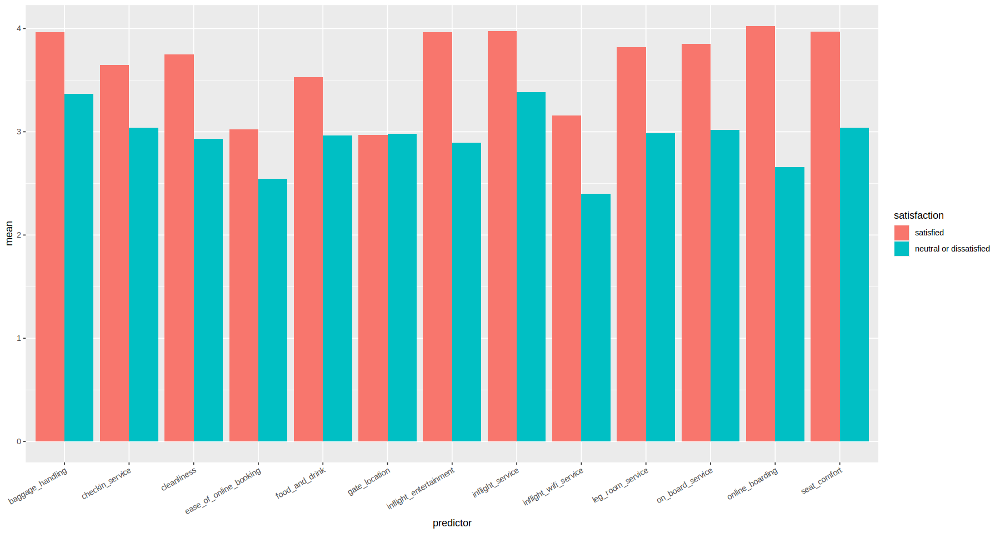

In [80]:
airplane_means_grouped_long <- airplane_means_grouped |>
                                select(satisfaction, inflight_wifi_service, ease_of_online_booking:cleanliness) |>
                                pivot_longer(
                                            cols = inflight_wifi_service:cleanliness,
                                            names_to = "predictor",
                                            values_to = "mean")
                                

airplane_means_grouped_long

options(repr.plot.width = 15, repr.plot.height = 8)

plot1 <- airplane_means_grouped_long |>
       ggplot(aes(x = predictor, y = mean, fill = satisfaction)) +
       geom_bar(stat = "identity", position = "dodge", width = 0.9) + 
       theme(axis.text.x = element_text(angle = 30, hjust = 1))
plot1 #NEED TO RENAME AND ADD TITLES
              
                  
# plot_wifi <- airplane_train |>
#         ggplot(aes(x = inflight_wifi_service, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_wifi 

# plot_departure_arrival <- airplane_train |>
#         ggplot(aes(x = departure_arrival_time_convenient, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_departure_arrival

# plot_online_booking <- airplane_train |>
#         ggplot(aes(x = ease_of_online_booking, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_online_booking

# plot_gate_location <- airplane_train |>
#         ggplot(aes(x = gate_location, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_gate_location

# plot_food_and_drink <- airplane_train |>
#         ggplot(aes(x = food_and_drink, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_food_and_drink 

# plot_online_boarding <- airplane_train |>
#         ggplot(aes(x = online_boarding, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_online_boarding

# plot_seat_comfort <- airplane_train |>
#         ggplot(aes(x = seat_comfort, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_seat_comfort 

# plot_entertainment <- airplane_train |>
#         ggplot(aes(x = inflight_entertainment, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_entertainment

# plot_onboard_service <- airplane_train |>
#         ggplot(aes(x = on_board_service, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_onboard_service

# plot_leg_room_service <- airplane_train |>
#         ggplot(aes(x = leg_room_service, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_leg_room_service

# plot_baggage_handling <- airplane_train |>
#         ggplot(aes(x = baggage_handling, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_baggage_handling

# plot_checkin_service <- airplane_train |>
#         ggplot(aes(x = checkin_service, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_checkin_service

# plot_cleanliness <- airplane_train |>
#         ggplot(aes(x = cleanliness, fill = satisfaction)) +
#                 geom_bar(stat = "count", position = "dodge")
# plot_cleanliness


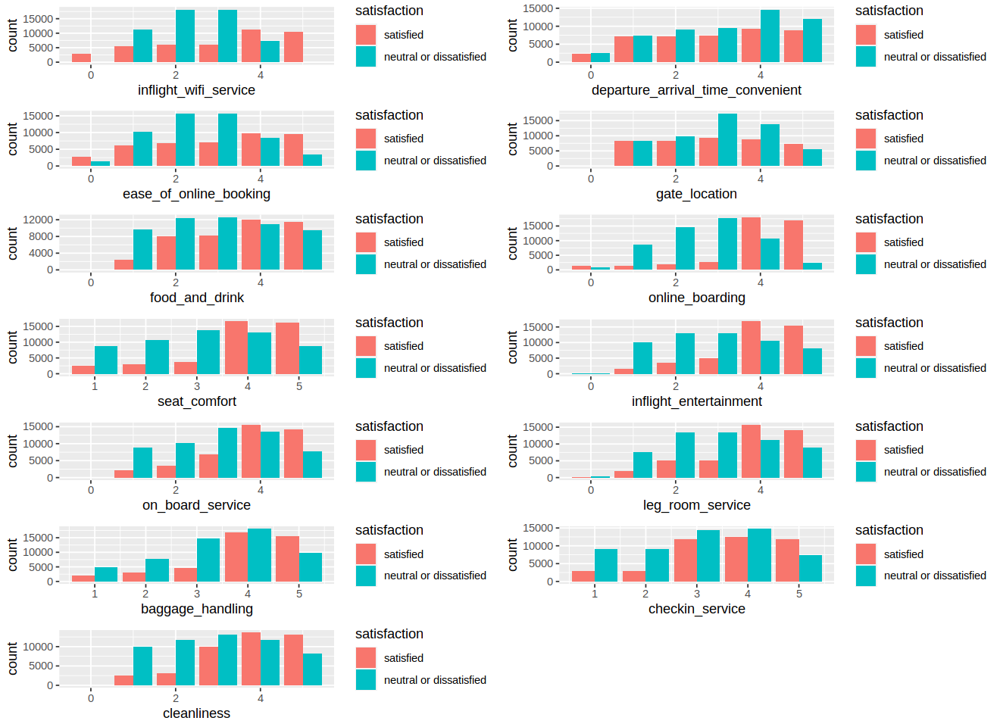

In [73]:
all_plots <- grid.arrange(plot_wifi, plot_departure_arrival, plot_online_booking, plot_gate_location, 
                        plot_food_and_drink, plot_online_boarding, plot_seat_comfort, plot_entertainment,
                        plot_onboard_service, plot_leg_room_service, plot_baggage_handling, plot_checkin_service,
                        plot_cleanliness, ncol = 2)

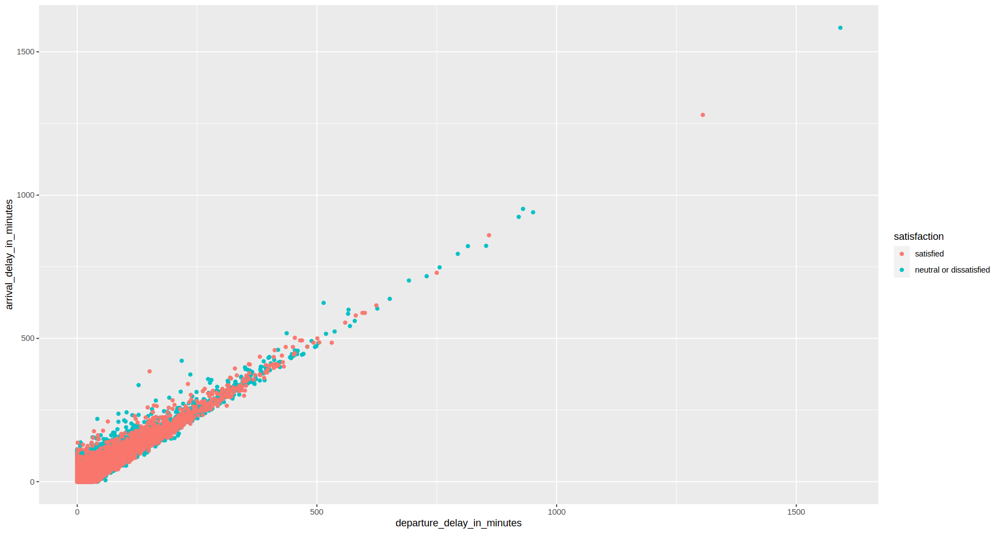

In [87]:
plot2 <- airplane_train |>
         ggplot(aes(x = departure_delay_in_minutes, y = arrival_delay_in_minutes, color = satisfaction)) +
         geom_point(alpha = 0.95)

plot2